In [1]:
%cd ..
%ls

/home/nas3_userJ/dmkim/OnlineTSAD
cfgs/         data/  Exp/     logs/    outputs/  results/  train.py*  Vis/
checkpoints/  EDA/   hptune/  models/  plots/    test.py*  utils/     wandb/


In [2]:
import torch
from torch import optim
import torch.nn.functional as F

import matplotlib.pyplot as plt

from utils.metrics import get_summary_stats

from models.MLP import MLP

import wandb
import hydra
from omegaconf import DictConfig

from utils.logger import make_logger
from utils.argpass import prepare_arguments, configure_exp_id
from utils.tools import SEED_everything, plot_interval

import warnings
from data.load_data import DataFactory
from Exp.ReconBaselines import *

from easydict import EasyDict as edict
import yaml
import re
import copy

warnings.filterwarnings("ignore")

In [18]:
# load yaml
cfg = {}
loader = yaml.SafeLoader
loader.add_implicit_resolver(
    u'tag:yaml.org,2002:float',
    re.compile(u'''^(?:
     [-+]?(?:[0-9][0-9_]*)\\.[0-9_]*(?:[eE][-+]?[0-9]+)?
    |[-+]?(?:[0-9][0-9_]*)(?:[eE][-+]?[0-9]+)
    |\\.[0-9_]+(?:[eE][-+][0-9]+)?
    |[-+]?[0-9][0-9_]*(?::[0-5]?[0-9])+\\.[0-9_]*
    |[-+]?\\.(?:inf|Inf|INF)
    |\\.(?:nan|NaN|NAN))$''', re.X),
    list(u'-+0123456789.'))

# get cfg
model = "MLP"
with open("cfgs/test_defaults.yaml", "r") as file:
    basic_config = yaml.load(file, Loader=loader)
    cfg.update(basic_config)
with open(f"cfgs/model/{model}.yaml", "r") as file:
    model_config = yaml.load(file, Loader=loader)
    cfg.update({"model": model_config})
cfg['dataset'] = 'Pump'
cfg['use_RevIN'] = False
cfg['exp_id'] = "MLP_Pump"

In [19]:
args = prepare_arguments(cfg)
args.model.latent_dim = 128
args.window_size = 12
args.eval_batch_size = 1
args.dataset = "Pump"
print(args)

logger = make_logger(os.path.join(args.log_path, f'{args.exp_id}.log'))
logger.info(f"Configurations: {args}")

# Data
logger.info(f"Preparing {args.dataset} dataset...")
datafactory = DataFactory(args, logger)
train_dataset, train_loader, test_dataset, test_loader = datafactory()
args.num_channels = train_dataset.X.shape[1]
train_X, train_y, test_X, test_y = train_dataset.X, train_dataset.y, test_dataset.X, test_dataset.y

print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

[2023-04-10 13:42:19,430] Configurations: {'exp_id': 'MLP_Pump', 'infer_options': ['offline', 'online_us_bce_seq'], 'dataset': 'Pump', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'ttlr': 0.001, 'thlr': 0.001, 'log_freq': 10, 'checkpoint_path': './checkpoints/MLP_Pump', 'log_path': './logs/MLP_Pump', 'output_path': './outputs/MLP_Pump', 'plot_path': './plots/MLP_Pump', 'result_path': './results/MLP_Pump', 'plot_anomaly_scores': True, 'plot_recon_status': False, 'defaults': [{'model': 'MLP'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'use_RevIN': False, 'home_dir': '.', 'device': device(type='cuda')}
[2023-04-10 13:42:19,431] Preparing Pump dataset...
[2023-04-10 13:42:19,432] current location: /home/nas3_userJ/dmkim/OnlineTSAD
[2023-04-10 13:42:19,433] Preparing Pump ...


{'exp_id': 'MLP_Pump', 'infer_options': ['offline', 'online_us_bce_seq'], 'dataset': 'Pump', 'batch_size': 64, 'eval_batch_size': 1, 'window_size': 12, 'stride': 1, 'eval_stride': 12, 'scaler': 'std', 'load_previous_error': True, 'lr': 0.001, 'epochs': 30, 'TT_loss': 'bce', 'cls_lambda': 1, 'ttlr': 0.001, 'thlr': 0.001, 'log_freq': 10, 'checkpoint_path': './checkpoints/MLP_Pump', 'log_path': './logs/MLP_Pump', 'output_path': './outputs/MLP_Pump', 'plot_path': './plots/MLP_Pump', 'result_path': './results/MLP_Pump', 'plot_anomaly_scores': True, 'plot_recon_status': False, 'defaults': [{'model': 'MLP'}], 'model': {'name': 'MLP', 'latent_dim': 128}, 'use_RevIN': False, 'home_dir': '.', 'device': device(type='cuda')}


[2023-04-10 13:42:22,711] train: X - (110160, 50), y - (110160,) test: X - (110160, 50), y - (110160,)
[2023-04-10 13:42:22,735] Complete.
[2023-04-10 13:42:22,736] Preparing dataloader...
[2023-04-10 13:42:22,938] total train dataset- 1722, batch_X - torch.Size([64, 12, 50]), batch_y - torch.Size([64, 12])
[2023-04-10 13:42:22,940] total test dataset- 9180, batch_X - torch.Size([1, 12, 50]), batch_y - torch.Size([1, 12])
[2023-04-10 13:42:22,941] Complete.


(110160, 50) (110160,) (110160, 50) (110160,)


## Visualize

In [ ]:
for c in range(args.num_channels):
    dataset_name = "pump"
    plt.figure(figsize=(20, 6), dpi=500)
    plt.plot(train_X[:, c], color="C0")
    plt.plot(range(len(train_X), len(train_X)+len(test_X)), test_X[:, c], color="black")
    label = np.concatenate([np.array([0]*len(train_X)), test_y])
    plot_interval(plt, label)
    plt.title(f"{dataset_name} feature {c}")
    plt.show()

## Load Model

In [25]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_Pump", f"best.pth"))

[2023-04-10 13:43:18,852] loading: ./checkpoints/MLP_Pump/best.pth @Trainer - torch.load_state_dict
[2023-04-10 13:43:18,866] train_errors.pt file exists, loading...
[2023-04-10 13:43:18,871] torch.Size([110149, 12])
[2023-04-10 13:43:18,872] test_errors.pt file exists, loading...
[2023-04-10 13:43:18,874] torch.Size([9180, 12])
[2023-04-10 13:43:18,947] Best threshold found at: 2.8443703651428223, with fpr: 0.004800739786130977, tpr: 0.6242801739334822
tn: 101164 fn: 3197
fp: 487 tp: 5312
[2023-04-10 13:43:18,948] loading: ./checkpoints/MLP_Pump/best.pth @Trainer - torch.load_state_dict


In [26]:
next(iter(tester.model.parameters())).device, next(iter(tester.model.parameters())).requires_grad

(device(type='cuda', index=0), True)

## Training statistics

In [27]:
train_iterator = tqdm(
    tester.train_loader,
    total=len(tester.train_loader),
    desc="calculating reconstruction errors",
    leave=True
)

recon_errors = []
with torch.no_grad():
    for i, batch_data in enumerate(train_iterator):
        X = batch_data[0].to(args.device)
        B, L, C = X.shape
        Xhat = tester.model(X)
        recon_error = torch.nn.functional.mse_loss(Xhat, X, reduction='none')
        recon_errors.append(recon_error)

recon_errors = torch.cat(recon_errors, axis=0)

train_error_dist = recon_errors.mean(dim=(1, 2))

print(f"{recon_errors.shape}, {train_error_dist.shape}")

calculating reconstruction errors: 100%|██████████| 1722/1722 [00:03<00:00, 469.85it/s]

torch.Size([110149, 12, 50]), torch.Size([110149])


## Test: static threshold inference

In [28]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

anoscs_prev = []
Xhats_prev = []
with torch.no_grad():
    for i, batch_data in enumerate(eval_iterator):
        X, y = batch_data[0].to(args.device), batch_data[1].to(args.device)
        B, L, C = X.shape
        Xhat = tester.model(X)
        Xhats_prev.append(Xhat)        
        e = F.mse_loss(Xhat, X, reduction='none')
        anosc = e.mean(dim=2)
        anoscs_prev.append(anosc)

Xhats_prev = torch.cat(Xhats_prev, axis=0).detach().cpu().numpy()
anoscs_prev = torch.cat(anoscs_prev, axis=0).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors: 100%|██████████| 9180/9180 [00:07<00:00, 1195.46it/s]


In [29]:
th_q95 = torch.quantile(train_error_dist, 0.95).item()
th_q99 = torch.quantile(train_error_dist, 0.99).item()
th_q100 = torch.max(train_error_dist).item()
th_best_static = tester.get_best_static_threshold(gt=test_y, anomaly_scores=anoscs_prev)
th_q95, th_q99, th_q100, th_best_static

[2023-04-10 13:43:42,231] Best threshold found at: 2.8443703651428223, with fpr: 0.004800739786130977, tpr: 0.6242801739334822
tn: 101164 fn: 3197
fp: 487 tp: 5312


(0.028445998206734657, 0.10091531276702881, 0.7540740370750427, 2.8443704)

In [30]:
# 95
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q95))
# 99
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q99))
# 100
print(get_summary_stats(test_dataset.y, anoscs_prev > th_q100))
# oracle
print(get_summary_stats(test_dataset.y, anoscs_prev > th_best_static))

{'Accuracy': 0.10143427741466957, 'Precision': 0.07915717010093493, 'Recall': 1.0, 'F1': 0.14670183786765972, 'tn': 2665, 'fp': 98986, 'fn': 0, 'tp': 8509}
{'Accuracy': 0.6909313725490196, 'Precision': 0.1999483034119748, 'Recall': 1.0, 'F1': 0.333261529423284, 'tn': 67604, 'fp': 34047, 'fn': 0, 'tp': 8509}
{'Accuracy': 0.8517066085693537, 'Precision': 0.2946639382968676, 'Recall': 0.6600070513573862, 'F1': 0.4074289030760302, 'tn': 88208, 'fp': 13443, 'fn': 2893, 'tp': 5616}
{'Accuracy': 0.9665395787944807, 'Precision': 0.9158475599241248, 'Recall': 0.6241626513103773, 'F1': 0.7423818842605535, 'tn': 101163, 'fp': 488, 'fn': 3198, 'tp': 5311}


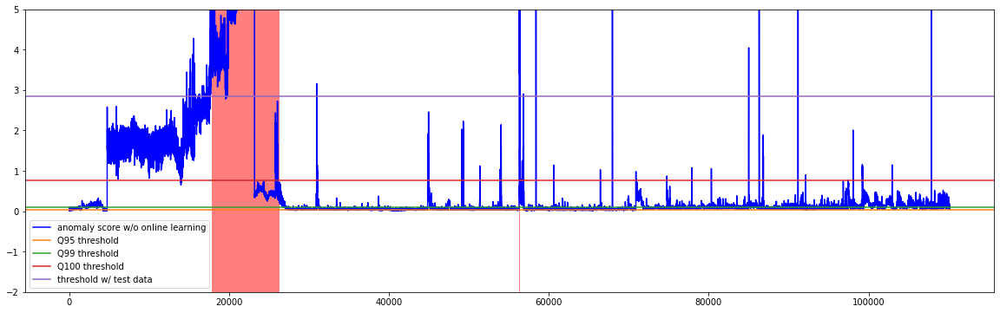

In [31]:
plt.figure(figsize=(20, 6))
plt.ylim([-2, 5])
plt.plot(anoscs_prev, color="blue", label="anomaly score w/o online learning")
#plt.plot(anoscs, color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="C1", label="Q95 threshold")
plt.axhline(th_q99, color="C2", label="Q99 threshold")
plt.axhline(th_q100, color="C3", label="Q100 threshold")
plt.axhline(th_best_static, color="C4", label="threshold w/ test data")

#plt.plot(thrs, color="gold",label="dynamic threshold")
plt.legend()
plot_interval(plt, test_y)
plt.show()

## EMA

In [13]:
import torch
import copy
from utils.tools import set_requires_grad

def set_requires_grad(model, val):
    for p in model.parameters():
        p.requires_grad = val
        
class EMAUpdater:
    def __init__(self, source_model, target_model, moving_average_decay, start_iter=0):
        super().__init__()
        self.source_model = source_model
        self.target_model = target_model
        self.moving_average_decay = moving_average_decay
        self.start_iter = start_iter

        set_requires_grad(self.target_model, False)
        self._update_moving_average(0.0)

    def _update_moving_average(self, moving_average_decay):
        with torch.no_grad():
            for target_params, source_params in zip(self.target_model.parameters(), self.source_model.parameters()):
                target_params.copy_(source_params.lerp(target_params, moving_average_decay))
            for target_buffers, source_buffers in zip(self.target_model.buffers(), self.source_model.buffers()):
                target_buffers.copy_(source_buffers)
    
    def update(self, iter_count):
        if iter_count < self.start_iter:
            self._update_moving_average(0.0)
        else:
            self._update_moving_average(self.moving_average_decay)

In [14]:
import torch
def f1_loss(y_pred, y_true):
    tp = (y_true*y_pred).sum(dim=0)
    tn = ((1-y_true)*(1-y_pred)).sum(dim=0)
    fp = ((1-y_true)*y_pred).sum(dim=0)
    fn = (y_true*(1-y_pred)).sum(dim=0)
    
    soft_f1_class1 = 2*tp / (2*tp + fn + fp + 1e-16)
    soft_f1_class0 = 2*tn / (2*tn + fn + fp + 1e-16)
    
    cost_class1 = 1-soft_f1_class1
    cost_class0 = 1-soft_f1_class0
    
    cost = 0.5*(cost_class1+cost_class0)
    return cost.mean()

In [15]:
import torch.nn as nn
'''
https://pytorch.org/vision/main/_modules/torchvision/ops/focal_loss.html
'''
class FocalLoss(nn.Module):
    def __init__(self, alpha=0.25, gamma=2):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
    def forward(self, inputs, targets):
        '''
        inputs: 0 < p < 1
        targets: 0, 1
        '''        
        p = inputs
        ce_loss = F.binary_cross_entropy(inputs, targets, reduction='none')
        p_t = p*targets + (1-p)*(1-targets)
        alpha_t = self.alpha * targets + (1 -self.alpha)*(1-targets)
        F_loss = alpha_t * ((1-p_t)**self.gamma) * ce_loss
        return F_loss.mean()

## Value-based Pseudo-label guided Online Learning (separate threshold)

### 1. Single+CE

In [106]:
thr = torch.quantile(train_error_dist, 1.00).detach().item()
init_thr = torch.quantile(train_error_dist, 1.00).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr, init_thr

(tensor(0.7541, requires_grad=True), 0.7540740370750427)

In [107]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_Pump", f"best.pth"))

[2023-04-10 14:16:50,910] loading: ./checkpoints/MLP_Pump/best.pth @Trainer - torch.load_state_dict
[2023-04-10 14:16:51,135] train_errors.pt file exists, loading...
[2023-04-10 14:16:51,143] torch.Size([110149, 12])
[2023-04-10 14:16:51,145] test_errors.pt file exists, loading...
[2023-04-10 14:16:51,148] torch.Size([9180, 12])
[2023-04-10 14:16:51,220] Best threshold found at: 2.8443703651428223, with fpr: 0.004800739786130977, tpr: 0.6242801739334822
tn: 101164 fn: 3197
fp: 487 tp: 5312
[2023-04-10 14:16:51,221] loading: ./checkpoints/MLP_Pump/best.pth @Trainer - torch.load_state_dict


In [108]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([p for p in tester.model.parameters()], lr=lr)
TH_optimizer = torch.optim.SGD([thr], lr=1e-03)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    
    # inference
    
    
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    
    thrp = torch.clamp(thr, min=init_thr)
    ytilde = (A > thrp).float()
    pred = (A > thrp)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thrp.clone().detach().item())
    
    # learn new-normals
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    recon_loss = (A*mask).mean()
    recon_loss.backward()
    TT_optimizer.step()
    
    # update threshold
    TH_optimizer.zero_grad()
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    thrp = torch.clamp(thr, min=init_thr)
    yhat = torch.sigmoid((A-thrp))
    cls_loss = bce(yhat, ytilde)
    cls_loss.backward()
    print(thr.grad, thr.item())
    TH_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

calculating reconstruction errors:   0%|          | 22/9180 [00:00<01:19, 114.57it/s]

tensor(-0.3248) 0.7540740370750427
tensor(-0.3263) 0.7543988227844238
tensor(-0.3279) 0.7547251582145691
tensor(-0.3240) 0.7550530433654785
tensor(-0.3262) 0.7553770542144775
tensor(-0.3254) 0.7557032108306885
tensor(-0.3343) 0.7560286521911621
tensor(-0.3353) 0.7563629746437073
tensor(-0.3238) 0.7566982507705688
tensor(-0.3219) 0.7570220828056335
tensor(-0.3244) 0.7573440074920654
tensor(-0.3236) 0.7576683759689331
tensor(-0.3216) 0.7579919695854187
tensor(-0.3214) 0.7583135962486267
tensor(-0.3231) 0.7586349844932556
tensor(-0.3232) 0.7589580416679382
tensor(-0.3225) 0.7592812776565552
tensor(-0.3236) 0.7596037983894348
tensor(-0.3239) 0.7599273920059204
tensor(-0.3248) 0.7602512836456299
tensor(-0.3241) 0.760576069355011
tensor(-0.3228) 0.7609001994132996
tensor(-0.3260) 0.7612230181694031
tensor(-0.3255) 0.7615490555763245
tensor(-0.3243) 0.7618745565414429
tensor(-0.3219) 0.7621988654136658
tensor(-0.3226) 0.7625207304954529
tensor(-0.3221) 0.7628433108329773
tensor(-0.3227) 0.763

calculating reconstruction errors:   1%|          | 56/9180 [00:00<01:01, 147.85it/s]

tensor(-0.3203) 0.7634881138801575
tensor(-0.3211) 0.7638084292411804
tensor(-0.3246) 0.7641295194625854
tensor(-0.3286) 0.7644541263580322
tensor(-0.3253) 0.764782726764679
tensor(-0.3236) 0.765108048915863
tensor(-0.3212) 0.7654315829277039
tensor(-0.3218) 0.7657527923583984
tensor(-0.3209) 0.766074538230896
tensor(-0.3221) 0.7663954496383667
tensor(-0.3223) 0.7667174935340881
tensor(-0.3222) 0.7670398354530334
tensor(-0.3221) 0.7673620581626892
tensor(-0.3212) 0.7676841616630554
tensor(-0.3226) 0.76800537109375
tensor(-0.3196) 0.7683279514312744
tensor(-0.3201) 0.7686475515365601
tensor(-0.3225) 0.7689676880836487
tensor(-0.3213) 0.7692901492118835
tensor(-0.3201) 0.7696114778518677
tensor(-0.3239) 0.7699316143989563
tensor(-0.3247) 0.7702555060386658
tensor(-0.3257) 0.7705802321434021
tensor(-0.3238) 0.7709059119224548
tensor(-0.3242) 0.7712296843528748
tensor(-0.3249) 0.7715539336204529
tensor(-0.3247) 0.7718787789344788
tensor(-0.3223) 0.7722034454345703
tensor(-0.3253) 0.7725257

calculating reconstruction errors:   1%|          | 90/9180 [00:00<00:57, 158.76it/s]

tensor(-0.3260) 0.7744694352149963
tensor(-0.3232) 0.774795413017273
tensor(-0.3225) 0.7751185894012451
tensor(-0.3215) 0.7754411101341248
tensor(-0.3213) 0.7757626175880432
tensor(-0.3230) 0.7760838866233826
tensor(-0.3241) 0.7764068245887756
tensor(-0.3222) 0.7767309546470642
tensor(-0.3222) 0.77705317735672
tensor(-0.3240) 0.777375340461731
tensor(-0.3237) 0.7776992917060852
tensor(-0.3232) 0.7780229449272156
tensor(-0.3222) 0.7783461809158325
tensor(-0.3225) 0.7786684036254883
tensor(-0.3235) 0.7789909243583679
tensor(-0.3227) 0.779314398765564
tensor(-0.3249) 0.7796370387077332
tensor(-0.3228) 0.779961884021759
tensor(-0.3224) 0.7802847027778625
tensor(-0.3226) 0.7806071043014526
tensor(-0.3208) 0.780929684638977
tensor(-0.3230) 0.7812504768371582
tensor(-0.3229) 0.7815735340118408
tensor(-0.3210) 0.7818964123725891
tensor(-0.3214) 0.7822173833847046
tensor(-0.3220) 0.7825387716293335
tensor(-0.3209) 0.7828608155250549
tensor(-0.3204) 0.7831817865371704
tensor(-0.3216) 0.783502161

calculating reconstruction errors:   1%|▏         | 122/9180 [00:00<00:57, 157.61it/s]

tensor(-0.3214) 0.7854286432266235
tensor(-0.3232) 0.7857500314712524
tensor(-0.3201) 0.7860732078552246
tensor(-0.3201) 0.7863932847976685
tensor(-0.3236) 0.7867134213447571
tensor(-0.3236) 0.7870369553565979
tensor(-0.3195) 0.7873605489730835
tensor(-0.3186) 0.7876800298690796
tensor(-0.3199) 0.7879986763000488
tensor(-0.3185) 0.7883185148239136
tensor(-0.3193) 0.7886370420455933
tensor(-0.3190) 0.7889562845230103
tensor(-0.3192) 0.7892752885818481
tensor(-0.3203) 0.7895944118499756
tensor(-0.3182) 0.7899146676063538
tensor(-0.3162) 0.7902328968048096
tensor(-0.3170) 0.790549099445343
tensor(-0.3160) 0.7908660769462585
tensor(-0.3166) 0.7911821007728577
tensor(-0.3165) 0.7914987206459045
tensor(-0.3155) 0.7918152809143066
tensor(-0.3194) 0.7921307682991028
tensor(-0.3160) 0.7924501895904541
tensor(-0.3150) 0.7927661538124084
tensor(-0.3157) 0.7930811643600464
tensor(-0.3159) 0.7933968901634216
tensor(-0.3162) 0.7937127947807312
tensor(-0.3161) 0.7940289974212646
tensor(-0.3160) 0.794

calculating reconstruction errors:   2%|▏         | 155/9180 [00:01<00:57, 156.74it/s]

tensor(-0.3143) 0.7956060171127319
tensor(-0.3154) 0.7959203720092773
tensor(-0.3147) 0.7962357997894287
tensor(-0.3139) 0.7965505123138428
tensor(-0.3141) 0.79686439037323
tensor(-0.3489) 0.7971784472465515
tensor(-0.3365) 0.7975273728370667
tensor(-0.3397) 0.7978639006614685
tensor(-0.3344) 0.7982036471366882
tensor(-0.3323) 0.7985380291938782
tensor(-0.3353) 0.798870325088501
tensor(-0.3344) 0.7992056012153625
tensor(-0.3358) 0.7995399832725525
tensor(-0.3298) 0.799875795841217
tensor(-0.3331) 0.8002055287361145
tensor(-0.3307) 0.8005385994911194
tensor(-0.3312) 0.8008692860603333
tensor(-0.3277) 0.8012004494667053
tensor(-0.3295) 0.8015281558036804
tensor(-0.3296) 0.8018576502799988
tensor(-0.3254) 0.8021872639656067
tensor(-0.3272) 0.8025127053260803
tensor(-0.3343) 0.8028399348258972
tensor(-0.3260) 0.8031742572784424
tensor(-0.3236) 0.803500235080719
tensor(-0.3232) 0.8038238286972046
tensor(-0.3219) 0.8041470646858215
tensor(-0.3196) 0.8044689893722534
tensor(-0.3224) 0.8047885

calculating reconstruction errors:   2%|▏         | 193/9180 [00:01<00:52, 172.44it/s]

tensor(-0.3204) 0.8060789108276367
tensor(-0.3207) 0.8063992857933044
tensor(-0.3199) 0.806719958782196
tensor(-0.3185) 0.8070398569107056
tensor(-0.3196) 0.8073583841323853
tensor(-0.3200) 0.8076779842376709
tensor(-0.3189) 0.8079979419708252
tensor(-0.3193) 0.8083168268203735
tensor(-0.3181) 0.8086361885070801
tensor(-0.3160) 0.8089542388916016
tensor(-0.3176) 0.8092702031135559
tensor(-0.3191) 0.8095877766609192
tensor(-0.3162) 0.8099068403244019
tensor(-0.3153) 0.8102231025695801
tensor(-0.3148) 0.8105384111404419
tensor(-0.3145) 0.8108532428741455
tensor(-0.3152) 0.8111677765846252
tensor(-0.3154) 0.8114830255508423
tensor(-0.3138) 0.8117983937263489
tensor(-0.3157) 0.8121122121810913
tensor(-0.3241) 0.8124278783798218
tensor(-0.3162) 0.8127520084381104
tensor(-0.3161) 0.8130682706832886
tensor(-0.3181) 0.8133843541145325
tensor(-0.3147) 0.8137024641036987
tensor(-0.3149) 0.8140171766281128
tensor(-0.3178) 0.8143320679664612
tensor(-0.3171) 0.8146498799324036
tensor(-0.3151) 0.814

calculating reconstruction errors:   3%|▎         | 233/9180 [00:01<00:48, 184.03it/s]

tensor(-0.3227) 0.818436861038208
tensor(-0.3162) 0.818759560585022
tensor(-0.3157) 0.8190757036209106
tensor(-0.3145) 0.8193914294242859
tensor(-0.3141) 0.8197059035301208
tensor(-0.3134) 0.8200199604034424
tensor(-0.3171) 0.8203334212303162
tensor(-0.3151) 0.8206505179405212
tensor(-0.3133) 0.820965588092804
tensor(-0.3164) 0.8212789297103882
tensor(-0.3145) 0.8215953707695007
tensor(-0.3164) 0.8219098448753357
tensor(-0.3166) 0.8222262263298035
tensor(-0.3169) 0.8225428462028503
tensor(-0.3189) 0.8228597640991211
tensor(-0.3177) 0.8231787085533142
tensor(-0.3144) 0.823496401309967
tensor(-0.3156) 0.8238108158111572
tensor(-0.3161) 0.8241263628005981
tensor(-0.3139) 0.8244425058364868
tensor(-0.3129) 0.824756383895874
tensor(-0.3123) 0.8250693082809448
tensor(-0.3122) 0.8253816366195679
tensor(-0.3119) 0.8256937861442566
tensor(-0.3216) 0.8260056376457214
tensor(-0.3244) 0.8263272643089294
tensor(-0.3235) 0.8266516923904419
tensor(-0.3167) 0.8269752264022827
tensor(-0.3142) 0.8272919

calculating reconstruction errors:   3%|▎         | 275/9180 [00:01<00:45, 195.41it/s]

tensor(-0.3140) 0.8310603499412537
tensor(-0.3140) 0.8313743472099304
tensor(-0.3165) 0.831688404083252
tensor(-0.3120) 0.8320049047470093
tensor(-0.3152) 0.8323169350624084
tensor(-0.3129) 0.8326321840286255
tensor(-0.3246) 0.8329450488090515
tensor(-0.3155) 0.8332695960998535
tensor(-0.3122) 0.8335851430892944
tensor(-0.3147) 0.8338974118232727
tensor(-0.3108) 0.834212064743042
tensor(-0.3101) 0.8345229029655457
tensor(-0.3135) 0.8348329663276672
tensor(-0.3114) 0.835146427154541
tensor(-0.3111) 0.8354578614234924
tensor(-0.3131) 0.83576899766922
tensor(-0.3127) 0.8360820412635803
tensor(-0.3108) 0.836394727230072
tensor(-0.3089) 0.8367055058479309
tensor(-0.3097) 0.8370144367218018
tensor(-0.3097) 0.8373242020606995
tensor(-0.3153) 0.8376339077949524
tensor(-0.3119) 0.8379492163658142
tensor(-0.3122) 0.838261067867279
tensor(-0.3127) 0.8385732173919678
tensor(-0.3100) 0.8388859033584595
tensor(-0.3148) 0.8391958475112915
tensor(-0.3139) 0.8395106792449951
tensor(-0.3124) 0.839824616

calculating reconstruction errors:   3%|▎         | 318/9180 [00:01<00:43, 203.40it/s]

tensor(-0.3113) 0.8442084789276123
tensor(-0.3119) 0.8445197343826294
tensor(-0.3105) 0.8448315858840942
tensor(-0.3102) 0.8451420664787292
tensor(-0.3128) 0.8454522490501404
tensor(-0.3102) 0.8457651138305664
tensor(-0.3123) 0.8460752964019775
tensor(-0.3107) 0.8463875651359558
tensor(-0.3118) 0.8466982841491699
tensor(-0.3100) 0.8470101356506348
tensor(-0.3138) 0.8473200798034668
tensor(-0.3187) 0.8476338982582092
tensor(-0.3226) 0.847952663898468
tensor(-0.3217) 0.8482752442359924
tensor(-0.3085) 0.8485969305038452
tensor(-0.3070) 0.8489055037498474
tensor(-0.3080) 0.8492125272750854
tensor(-0.3106) 0.8495205640792847
tensor(-0.3074) 0.8498311638832092
tensor(-0.3076) 0.8501385450363159
tensor(-0.3081) 0.8504461646080017
tensor(-0.3089) 0.8507542610168457
tensor(-0.3125) 0.8510631322860718
tensor(-0.3081) 0.8513755798339844
tensor(-0.3062) 0.8516837358474731
tensor(-0.3107) 0.8519899249076843
tensor(-0.3106) 0.8523006439208984
tensor(-0.3095) 0.852611243724823
tensor(-0.3122) 0.8529

calculating reconstruction errors:   4%|▍         | 362/9180 [00:02<00:42, 207.57it/s]

tensor(-0.3062) 0.8575375080108643
tensor(-0.3105) 0.8578437566757202
tensor(-0.3084) 0.858154296875
tensor(-0.3102) 0.8584627509117126
tensor(-0.3082) 0.8587729334831238
tensor(-0.3050) 0.8590811491012573
tensor(-0.3080) 0.859386146068573
tensor(-0.3063) 0.8596941828727722
tensor(-0.3065) 0.8600004315376282
tensor(-0.3067) 0.860306978225708
tensor(-0.3092) 0.8606136441230774
tensor(-0.3050) 0.8609228730201721
tensor(-0.3057) 0.8612278699874878
tensor(-0.3075) 0.861533522605896
tensor(-0.3125) 0.8618410229682922
tensor(-0.3055) 0.8621535897254944
tensor(-0.3072) 0.8624590635299683
tensor(-0.3069) 0.8627662062644958
tensor(-0.3045) 0.8630730509757996
tensor(-0.3069) 0.8633775115013123
tensor(-0.3051) 0.863684356212616
tensor(-0.3082) 0.8639894723892212
tensor(-0.3068) 0.8642976880073547
tensor(-0.3099) 0.8646044731140137
tensor(-0.3053) 0.8649143576622009
tensor(-0.3054) 0.8652196526527405
tensor(-0.3015) 0.8655250668525696
tensor(-0.3005) 0.8658265471458435
tensor(-0.3003) 0.8661270141

calculating reconstruction errors:   4%|▍         | 405/9180 [00:02<00:41, 209.03it/s]

tensor(-0.3021) 0.8706241250038147
tensor(-0.2993) 0.8709262609481812
tensor(-0.2980) 0.8712255954742432
tensor(-0.2993) 0.8715235590934753
tensor(-0.2980) 0.8718228340148926
tensor(-0.2988) 0.8721207976341248
tensor(-0.2972) 0.8724195957183838
tensor(-0.2974) 0.8727167844772339
tensor(-0.2974) 0.8730142116546631
tensor(-0.2970) 0.8733116388320923
tensor(-0.2973) 0.8736085891723633
tensor(-0.2991) 0.8739058971405029
tensor(-0.2978) 0.8742049932479858
tensor(-0.2971) 0.8745027780532837
tensor(-0.2983) 0.874799907207489
tensor(-0.2999) 0.8750981688499451
tensor(-0.2973) 0.8753980994224548
tensor(-0.2994) 0.8756954669952393
tensor(-0.2964) 0.8759949207305908
tensor(-0.2970) 0.8762913346290588
tensor(-0.2967) 0.8765883445739746
tensor(-0.2967) 0.8768850564956665
tensor(-0.2974) 0.8771817684173584
tensor(-0.2974) 0.8774791359901428
tensor(-0.2964) 0.877776563167572
tensor(-0.2969) 0.8780729174613953
tensor(-0.2962) 0.8783697485923767
tensor(-0.2961) 0.8786659836769104
tensor(-0.1699) 0.8789

calculating reconstruction errors:   5%|▍         | 447/9180 [00:02<00:41, 208.46it/s]

tensor(0.3532) 0.874777615070343
tensor(0.3735) 0.874424397945404
tensor(0.3342) 0.8740509152412415
tensor(0.3156) 0.8737167119979858
tensor(0.3089) 0.8734011054039001
tensor(0.3061) 0.8730922341346741
tensor(0.3100) 0.8727861046791077
tensor(0.3175) 0.8724760413169861
tensor(0.3066) 0.8721584677696228
tensor(0.3156) 0.8718518614768982
tensor(0.2976) 0.8715362548828125
tensor(0.2985) 0.8712387084960938
tensor(0.3269) 0.8709402084350586
tensor(0.3197) 0.8706133365631104
tensor(0.3324) 0.8702936172485352
tensor(0.3466) 0.8699612021446228
tensor(0.3594) 0.8696146011352539
tensor(0.3436) 0.8692552447319031
tensor(0.3256) 0.868911623954773
tensor(0.3118) 0.868586003780365
tensor(0.3471) 0.8682742118835449
tensor(0.3195) 0.8679271340370178
tensor(0.3344) 0.8676076531410217
tensor(0.3332) 0.867273211479187
tensor(0.3196) 0.8669399619102478
tensor(0.3500) 0.8666203022003174
tensor(0.3473) 0.8662703037261963
tensor(0.3090) 0.8659229874610901
tensor(0.2916) 0.8656139969825745
tensor(0.2979) 0.86

calculating reconstruction errors:   5%|▌         | 489/9180 [00:02<00:43, 201.35it/s]

tensor(0.2965) 0.8613013029098511
tensor(0.2575) 0.8610048294067383
tensor(0.3137) 0.8607472777366638
tensor(0.3174) 0.8604335784912109
tensor(0.3173) 0.860116183757782
tensor(0.3244) 0.8597989082336426
tensor(0.3384) 0.8594744801521301
tensor(0.3439) 0.8591361045837402
tensor(0.3266) 0.8587921857833862
tensor(0.3107) 0.8584655523300171
tensor(0.2985) 0.858154833316803
tensor(0.2929) 0.8578563332557678
tensor(0.3168) 0.8575634360313416
tensor(0.3171) 0.8572466373443604
tensor(0.3166) 0.8569295406341553
tensor(0.3145) 0.8566129207611084
tensor(0.3660) 0.8562984466552734
tensor(0.3610) 0.8559324741363525
tensor(0.3338) 0.855571448802948
tensor(0.3332) 0.8552376627922058
tensor(0.3423) 0.8549044132232666
tensor(0.3338) 0.8545621037483215
tensor(0.3089) 0.8542283177375793
tensor(0.3168) 0.8539194464683533
tensor(0.3227) 0.8536027073860168
tensor(0.3267) 0.8532800078392029
tensor(0.3004) 0.852953314781189
tensor(0.3008) 0.8526529669761658
tensor(0.2995) 0.8523521423339844
tensor(0.3102) 0.8

calculating reconstruction errors:   6%|▌         | 510/9180 [00:02<00:47, 183.33it/s]

tensor(0.4249) 0.848852276802063
tensor(0.3889) 0.848427414894104
tensor(0.3427) 0.8480384945869446
tensor(0.3120) 0.8476957678794861
tensor(0.3153) 0.8473837375640869
tensor(0.3051) 0.8470684885978699
tensor(0.2770) 0.8467634320259094
tensor(0.2732) 0.8464863896369934
tensor(0.3373) 0.8462132215499878
tensor(0.3515) 0.8458759784698486
tensor(0.3544) 0.8455244898796082
tensor(0.3601) 0.8451700210571289
tensor(0.3553) 0.8448099493980408
tensor(0.3748) 0.8444546461105347
tensor(0.3567) 0.8440799117088318
tensor(0.3454) 0.8437232375144958
tensor(0.4445) 0.8433778285980225
tensor(0.4040) 0.8429332971572876
tensor(0.3665) 0.842529296875
tensor(0.3372) 0.8421627879142761
tensor(0.3229) 0.8418256044387817
tensor(0.3104) 0.8415026664733887
tensor(0.3189) 0.8411922454833984
tensor(0.3329) 0.8408733606338501
tensor(0.3271) 0.8405404090881348
tensor(0.3781) 0.8402133584022522
tensor(0.3474) 0.8398352861404419
tensor(0.3367) 0.8394879102706909
tensor(0.3081) 0.8391512036323547
tensor(0.3106) 0.838

calculating reconstruction errors:   6%|▌         | 548/9180 [00:03<00:48, 179.33it/s]

tensor(0.3147) 0.8382318019866943
tensor(0.3110) 0.837917149066925
tensor(0.3213) 0.8376061320304871
tensor(0.3170) 0.8372848033905029
tensor(0.3113) 0.8369678258895874
tensor(0.3126) 0.8366565704345703
tensor(0.3059) 0.8363439440727234
tensor(0.3307) 0.8360379934310913
tensor(0.3273) 0.8357072472572327
tensor(0.3288) 0.8353798985481262
tensor(0.3119) 0.8350510597229004
tensor(0.3055) 0.8347391486167908
tensor(0.2978) 0.8344336152076721
tensor(0.2981) 0.8341358304023743
tensor(0.3162) 0.8338376879692078
tensor(0.2965) 0.8335214853286743
tensor(0.2927) 0.8332250118255615
tensor(0.3179) 0.8329322934150696
tensor(0.3144) 0.8326143622398376
tensor(0.3247) 0.8322999477386475
tensor(0.3240) 0.8319752216339111
tensor(0.3180) 0.8316512107849121
tensor(0.3025) 0.8313331604003906
tensor(0.3150) 0.8310306072235107
tensor(0.2940) 0.8307155966758728
tensor(0.2959) 0.8304215669631958
tensor(0.3067) 0.8301256895065308
tensor(0.2942) 0.8298190236091614
tensor(0.2871) 0.82952481508255
tensor(0.2916) 0.

calculating reconstruction errors:   6%|▋         | 586/9180 [00:03<00:46, 182.87it/s]

tensor(0.2912) 0.8269556164741516
tensor(0.2893) 0.826664388179779
tensor(0.2874) 0.8263750672340393
tensor(0.2879) 0.8260877132415771
tensor(0.2934) 0.825799822807312
tensor(0.3065) 0.8255064487457275
tensor(0.3035) 0.8252000212669373
tensor(0.3337) 0.8248964548110962
tensor(0.3395) 0.8245627284049988
tensor(0.2968) 0.8242232203483582
tensor(0.2927) 0.8239264488220215
tensor(0.3051) 0.8236337900161743
tensor(0.2918) 0.8233286738395691
tensor(0.2847) 0.8230369091033936
tensor(0.2832) 0.8227521777153015
tensor(0.2877) 0.8224689960479736
tensor(0.2937) 0.8221812844276428
tensor(0.2902) 0.8218875527381897
tensor(0.3125) 0.8215973377227783
tensor(0.3224) 0.821284830570221
tensor(0.3159) 0.8209624290466309
tensor(0.2966) 0.8206465244293213
tensor(0.2919) 0.820349931716919
tensor(0.2990) 0.8200580477714539
tensor(0.2921) 0.8197590708732605
tensor(0.3072) 0.8194669485092163
tensor(0.3008) 0.8191596865653992
tensor(0.3057) 0.8188588619232178
tensor(0.2946) 0.8185531497001648
tensor(0.3237) 0.8

calculating reconstruction errors:   7%|▋         | 626/9180 [00:03<00:45, 188.22it/s]

tensor(0.2839) 0.8152636289596558
tensor(0.3131) 0.8149797320365906
tensor(0.3097) 0.8146665692329407
tensor(0.3106) 0.814356803894043
tensor(0.3257) 0.8140461444854736
tensor(0.2909) 0.8137204051017761
tensor(0.2774) 0.8134294748306274
tensor(0.2802) 0.813152015209198
tensor(0.2916) 0.8128718733787537
tensor(0.2858) 0.8125802874565125
tensor(0.3067) 0.8122944831848145
tensor(0.3248) 0.8119877576828003
tensor(0.3114) 0.8116629123687744
tensor(0.2960) 0.8113515377044678
tensor(0.2901) 0.8110554814338684
tensor(0.2914) 0.8107653260231018
tensor(0.3021) 0.8104739785194397
tensor(0.3053) 0.810171902179718
tensor(0.3017) 0.8098666071891785
tensor(0.3071) 0.8095648884773254
tensor(0.3059) 0.8092578053474426
tensor(0.2926) 0.8089519143104553
tensor(0.2819) 0.8086593747138977
tensor(0.2787) 0.8083774447441101
tensor(0.2953) 0.8080987334251404
tensor(0.2903) 0.8078034520149231
tensor(0.2745) 0.8075131177902222
tensor(0.3057) 0.8072386384010315
tensor(0.3281) 0.8069329857826233
tensor(0.3326) 0.

calculating reconstruction errors:   7%|▋         | 664/9180 [00:03<00:45, 187.28it/s]

tensor(0.3072) 0.803456723690033
tensor(0.3274) 0.8031495213508606
tensor(0.2977) 0.8028221726417542
tensor(0.2783) 0.8025245070457458
tensor(0.2781) 0.8022462129592896
tensor(0.2764) 0.8019680380821228
tensor(0.2766) 0.8016915917396545
tensor(0.2607) 0.801414966583252
tensor(0.2424) 0.8011542558670044
tensor(0.2444) 0.8009119033813477
tensor(0.2525) 0.8006675243377686
tensor(0.2916) 0.8004149794578552
tensor(0.2884) 0.8001233339309692
tensor(0.2781) 0.7998349070549011
tensor(0.2741) 0.7995567917823792
tensor(0.2623) 0.7992826700210571
tensor(0.2731) 0.7990204095840454
tensor(0.2661) 0.7987473011016846
tensor(0.2671) 0.7984812259674072
tensor(0.2811) 0.7982140779495239
tensor(0.2744) 0.7979329824447632
tensor(0.2840) 0.7976585626602173
tensor(0.2820) 0.7973744869232178
tensor(0.2847) 0.7970924973487854
tensor(0.2885) 0.7968077659606934
tensor(0.2966) 0.7965192794799805
tensor(0.2933) 0.7962226867675781
tensor(0.2838) 0.7959294319152832
tensor(0.2617) 0.7956456542015076
tensor(0.2641) 0

calculating reconstruction errors:   8%|▊         | 702/9180 [00:03<00:45, 186.00it/s]

tensor(0.2662) 0.7931762337684631
tensor(0.2568) 0.7929100394248962
tensor(0.2731) 0.7926532030105591
tensor(0.3089) 0.792380154132843
tensor(0.3235) 0.7920712232589722
tensor(0.3911) 0.7917476892471313
tensor(0.4071) 0.79135662317276
tensor(0.3454) 0.7909495234489441
tensor(0.3196) 0.7906041741371155
tensor(0.2850) 0.7902846336364746
tensor(0.2898) 0.7899996042251587
tensor(0.2810) 0.7897098064422607
tensor(0.2869) 0.7894288301467896
tensor(0.2776) 0.7891419529914856
tensor(0.2836) 0.7888643145561218
tensor(0.2789) 0.7885807752609253
tensor(0.2920) 0.7883018851280212
tensor(0.2870) 0.7880099415779114
tensor(0.2867) 0.7877228856086731
tensor(0.3187) 0.7874361872673035
tensor(0.3081) 0.7871174812316895
tensor(0.2880) 0.7868093848228455
tensor(0.2736) 0.7865213751792908
tensor(0.2816) 0.7862478494644165
tensor(0.2929) 0.7859662175178528
tensor(0.3000) 0.7856732606887817
tensor(0.3032) 0.785373330116272
tensor(0.2989) 0.7850701212882996
tensor(0.2873) 0.784771203994751
tensor(0.2864) 0.78

calculating reconstruction errors:   8%|▊         | 740/9180 [00:04<00:45, 186.50it/s]

tensor(0.2841) 0.7818158864974976
tensor(0.2855) 0.781531810760498
tensor(0.2756) 0.7812463641166687
tensor(0.2738) 0.7809708118438721
tensor(0.2805) 0.7806969881057739
tensor(0.2937) 0.7804164886474609
tensor(0.2904) 0.7801228165626526
tensor(0.2739) 0.7798324227333069
tensor(0.2780) 0.7795584797859192
tensor(0.2685) 0.7792804837226868
tensor(0.2789) 0.7790120244026184
tensor(0.2813) 0.7787331342697144
tensor(0.3037) 0.7784518599510193
tensor(0.2979) 0.7781481742858887
tensor(0.2873) 0.777850329875946
tensor(0.2954) 0.7775630354881287
tensor(0.2993) 0.777267575263977
tensor(0.2973) 0.7769683003425598
tensor(0.2911) 0.7766710519790649
tensor(0.3008) 0.7763799428939819
tensor(0.3020) 0.7760791778564453
tensor(0.2856) 0.7757771611213684
tensor(0.2939) 0.7754915356636047
tensor(0.3066) 0.7751976251602173
tensor(0.3175) 0.7748910784721375
tensor(0.3072) 0.7745736241340637
tensor(0.2792) 0.7742664217948914
tensor(0.2798) 0.7739872336387634
tensor(0.3020) 0.7737074494361877
tensor(0.3138) 0.

calculating reconstruction errors:   8%|▊         | 778/9180 [00:04<00:45, 185.02it/s]

tensor(0.3126) 0.7705882787704468
tensor(0.3133) 0.7702756524085999
tensor(0.3459) 0.7699623703956604
tensor(0.3382) 0.769616425037384
tensor(0.3118) 0.7692782282829285
tensor(0.2877) 0.7689664363861084
tensor(0.3004) 0.7686787247657776
tensor(0.3010) 0.7683783173561096
tensor(0.2783) 0.7680773138999939
tensor(0.2824) 0.7677989602088928
tensor(0.2872) 0.7675164937973022
tensor(0.2903) 0.7672293186187744
tensor(0.2915) 0.7669389843940735
tensor(0.3023) 0.766647458076477
tensor(0.3133) 0.766345202922821
tensor(0.2991) 0.7660318613052368
tensor(0.2847) 0.7657327055931091
tensor(0.3049) 0.7654479742050171
tensor(0.2998) 0.765143096446991
tensor(0.3046) 0.7648432850837708
tensor(0.2955) 0.7645387053489685
tensor(0.3366) 0.7642431855201721
tensor(0.3049) 0.7639065980911255
tensor(0.3056) 0.7636017203330994
tensor(0.2873) 0.7632960677146912
tensor(0.3359) 0.7630087733268738
tensor(0.3293) 0.7626729011535645
tensor(0.2989) 0.7623435854911804
tensor(0.2919) 0.7620447278022766
tensor(0.2914) 0.7

calculating reconstruction errors:   9%|▉         | 817/9180 [00:04<00:44, 187.80it/s]

tensor(0.2710) 0.7594925761222839
tensor(0.2837) 0.7592215538024902
tensor(0.2715) 0.7589378356933594
tensor(0.2826) 0.7586663365364075
tensor(0.2897) 0.7583837509155273
tensor(0.2997) 0.758094072341919
tensor(0.2891) 0.7577943801879883
tensor(0.2987) 0.7575052976608276
tensor(0.3069) 0.7572065591812134
tensor(0.2910) 0.7568996548652649
tensor(0.2782) 0.7566086649894714
tensor(0.2953) 0.7563304901123047
tensor(0.2867) 0.7560351490974426
tensor(0.2733) 0.755748450756073
tensor(0.2688) 0.7554751634597778
tensor(0.2698) 0.7552063465118408
tensor(0.2661) 0.7549365162849426
tensor(0.2829) 0.7546703815460205
tensor(0.2910) 0.7543875575065613
tensor(0.2789) 0.7540965676307678
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.753817677

calculating reconstruction errors:   9%|▉         | 859/9180 [00:04<00:42, 196.05it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  10%|▉         | 902/9180 [00:04<00:41, 201.28it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  10%|█         | 943/9180 [00:05<00:41, 197.52it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  11%|█         | 983/9180 [00:05<00:42, 194.90it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  11%|█         | 1023/9180 [00:05<00:42, 192.80it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  12%|█▏        | 1065/9180 [00:05<00:41, 197.52it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  12%|█▏        | 1108/9180 [00:05<00:39, 202.94it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  13%|█▎        | 1150/9180 [00:06<00:39, 201.45it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  13%|█▎        | 1193/9180 [00:06<00:39, 204.74it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  13%|█▎        | 1235/9180 [00:06<00:38, 205.78it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  14%|█▍        | 1277/9180 [00:06<00:39, 202.04it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  14%|█▍        | 1298/9180 [00:06<00:39, 200.45it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  15%|█▍        | 1339/9180 [00:07<00:39, 196.09it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  15%|█▌        | 1381/9180 [00:07<00:38, 201.13it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  16%|█▌        | 1423/9180 [00:07<00:38, 202.63it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  16%|█▌        | 1465/9180 [00:07<00:38, 199.93it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  16%|█▋        | 1508/9180 [00:07<00:37, 205.32it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  17%|█▋        | 1552/9180 [00:08<00:36, 209.85it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  17%|█▋        | 1596/9180 [00:08<00:35, 210.72it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  18%|█▊        | 1640/9180 [00:08<00:35, 210.42it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  18%|█▊        | 1684/9180 [00:08<00:35, 212.22it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  19%|█▉        | 1729/9180 [00:08<00:34, 214.16it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  19%|█▉        | 1774/9180 [00:09<00:34, 217.59it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  20%|█▉        | 1820/9180 [00:09<00:33, 220.37it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  20%|██        | 1866/9180 [00:09<00:32, 223.21it/s]


tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.

calculating reconstruction errors:  21%|██        | 1912/9180 [00:09<00:32, 223.92it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  21%|██▏       | 1958/9180 [00:09<00:32, 221.01it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  22%|██▏       | 2004/9180 [00:10<00:33, 211.62it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  22%|██▏       | 2047/9180 [00:10<00:35, 202.03it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  23%|██▎       | 2068/9180 [00:10<00:36, 194.56it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  23%|██▎       | 2108/9180 [00:10<00:37, 188.20it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  23%|██▎       | 2146/9180 [00:10<00:37, 186.56it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  24%|██▍       | 2187/9180 [00:11<00:35, 195.78it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  24%|██▍       | 2231/9180 [00:11<00:33, 206.54it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  25%|██▍       | 2274/9180 [00:11<00:33, 208.49it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  25%|██▌       | 2316/9180 [00:11<00:33, 203.49it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  26%|██▌       | 2356/9180 [00:12<00:37, 182.43it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  26%|██▌       | 2394/9180 [00:12<00:37, 180.98it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  27%|██▋       | 2433/9180 [00:12<00:36, 184.90it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  27%|██▋       | 2473/9180 [00:12<00:35, 190.43it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  27%|██▋       | 2493/9180 [00:12<00:35, 189.70it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  28%|██▊       | 2533/9180 [00:12<00:35, 188.51it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  28%|██▊       | 2571/9180 [00:13<00:35, 186.02it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  28%|██▊       | 2609/9180 [00:13<00:35, 184.11it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  29%|██▉       | 2650/9180 [00:13<00:33, 192.54it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  29%|██▉       | 2695/9180 [00:13<00:31, 205.89it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  30%|██▉       | 2740/9180 [00:14<00:30, 214.24it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  30%|███       | 2784/9180 [00:14<00:31, 201.28it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  31%|███       | 2825/9180 [00:14<00:33, 188.41it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  31%|███       | 2863/9180 [00:14<00:35, 177.69it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  31%|███▏      | 2881/9180 [00:14<00:36, 173.15it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  32%|███▏      | 2918/9180 [00:15<00:36, 171.47it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  32%|███▏      | 2957/9180 [00:15<00:34, 178.98it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  33%|███▎      | 2995/9180 [00:15<00:33, 182.41it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  33%|███▎      | 3033/9180 [00:15<00:33, 182.35it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  34%|███▎      | 3076/9180 [00:15<00:31, 195.37it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  34%|███▍      | 3118/9180 [00:16<00:30, 200.99it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  34%|███▍      | 3162/9180 [00:16<00:29, 207.10it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  35%|███▍      | 3204/9180 [00:16<00:29, 203.87it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  35%|███▌      | 3246/9180 [00:16<00:30, 195.67it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  36%|███▌      | 3286/9180 [00:16<00:31, 188.72it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  36%|███▌      | 3325/9180 [00:17<00:30, 189.69it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  37%|███▋      | 3365/9180 [00:17<00:30, 190.43it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  37%|███▋      | 3385/9180 [00:17<00:31, 185.55it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  37%|███▋      | 3422/9180 [00:17<00:33, 169.83it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  38%|███▊      | 3461/9180 [00:17<00:31, 179.99it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  38%|███▊      | 3501/9180 [00:18<00:30, 187.11it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  39%|███▊      | 3541/9180 [00:18<00:29, 190.52it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  39%|███▉      | 3582/9180 [00:18<00:28, 194.61it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  39%|███▉      | 3624/9180 [00:18<00:27, 200.11it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  40%|███▉      | 3667/9180 [00:18<00:26, 205.45it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  40%|████      | 3710/9180 [00:19<00:26, 207.66it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  41%|████      | 3753/9180 [00:19<00:26, 208.56it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  41%|████▏     | 3796/9180 [00:19<00:25, 211.96it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  42%|████▏     | 3840/9180 [00:19<00:24, 214.65it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  42%|████▏     | 3885/9180 [00:19<00:24, 215.42it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  43%|████▎     | 3929/9180 [00:20<00:24, 217.38it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  43%|████▎     | 3975/9180 [00:20<00:23, 222.37it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  44%|████▍     | 4021/9180 [00:20<00:23, 220.41it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  44%|████▍     | 4067/9180 [00:20<00:23, 221.78it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  45%|████▍     | 4113/9180 [00:20<00:23, 219.58it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  45%|████▌     | 4159/9180 [00:21<00:22, 220.82it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  46%|████▌     | 4205/9180 [00:21<00:22, 221.08it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  46%|████▋     | 4251/9180 [00:21<00:22, 222.42it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  47%|████▋     | 4297/9180 [00:21<00:22, 221.49it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  47%|████▋     | 4343/9180 [00:22<00:22, 218.80it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  48%|████▊     | 4387/9180 [00:22<00:22, 216.61it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  48%|████▊     | 4431/9180 [00:22<00:21, 217.15it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  49%|████▊     | 4475/9180 [00:22<00:21, 215.62it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  49%|████▉     | 4519/9180 [00:22<00:21, 214.22it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  50%|████▉     | 4562/9180 [00:23<00:22, 209.02it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  50%|█████     | 4606/9180 [00:23<00:21, 210.92it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  50%|█████     | 4628/9180 [00:23<00:21, 210.81it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  51%|█████     | 4672/9180 [00:23<00:21, 210.05it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  51%|█████▏    | 4716/9180 [00:23<00:21, 208.78it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  52%|█████▏    | 4758/9180 [00:23<00:21, 208.99it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  52%|█████▏    | 4801/9180 [00:24<00:20, 208.82it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  53%|█████▎    | 4843/9180 [00:24<00:20, 208.01it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  53%|█████▎    | 4886/9180 [00:24<00:20, 211.43it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  54%|█████▎    | 4932/9180 [00:24<00:19, 219.41it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  54%|█████▍    | 4977/9180 [00:25<00:19, 217.81it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  55%|█████▍    | 5022/9180 [00:25<00:19, 218.19it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  55%|█████▌    | 5066/9180 [00:25<00:18, 218.30it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  56%|█████▌    | 5111/9180 [00:25<00:18, 218.68it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  56%|█████▌    | 5154/9180 [00:25<00:20, 198.31it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  57%|█████▋    | 5194/9180 [00:26<00:21, 188.17it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  57%|█████▋    | 5233/9180 [00:26<00:20, 188.24it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  57%|█████▋    | 5272/9180 [00:26<00:20, 187.34it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  58%|█████▊    | 5311/9180 [00:26<00:20, 189.25it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  58%|█████▊    | 5349/9180 [00:26<00:20, 186.06it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  59%|█████▊    | 5389/9180 [00:27<00:19, 191.44it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  59%|█████▉    | 5409/9180 [00:27<00:19, 190.34it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  59%|█████▉    | 5448/9180 [00:27<00:19, 188.89it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  60%|█████▉    | 5487/9180 [00:27<00:19, 189.51it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  60%|██████    | 5525/9180 [00:27<00:19, 189.23it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  61%|██████    | 5566/9180 [00:28<00:18, 193.68it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  61%|██████    | 5606/9180 [00:28<00:18, 190.56it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  62%|██████▏   | 5646/9180 [00:28<00:18, 192.08it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  62%|██████▏   | 5686/9180 [00:28<00:18, 191.21it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  62%|██████▏   | 5726/9180 [00:28<00:17, 194.72it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  63%|██████▎   | 5766/9180 [00:29<00:17, 192.62it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  63%|██████▎   | 5805/9180 [00:29<00:17, 188.61it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  64%|██████▎   | 5843/9180 [00:29<00:17, 187.48it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  64%|██████▍   | 5881/9180 [00:29<00:17, 186.14it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  64%|██████▍   | 5919/9180 [00:29<00:19, 168.59it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  65%|██████▍   | 5955/9180 [00:30<00:19, 169.10it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  65%|██████▌   | 5997/9180 [00:30<00:17, 187.01it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  66%|██████▌   | 6036/9180 [00:30<00:16, 188.11it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  66%|██████▌   | 6074/9180 [00:30<00:16, 184.43it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  66%|██████▋   | 6093/9180 [00:30<00:16, 183.39it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  67%|██████▋   | 6131/9180 [00:31<00:16, 184.02it/s]


tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.

calculating reconstruction errors:  67%|██████▋   | 6169/9180 [00:31<00:16, 184.65it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  68%|██████▊   | 6207/9180 [00:31<00:16, 185.11it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  68%|██████▊   | 6245/9180 [00:31<00:16, 176.26it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  68%|██████▊   | 6283/9180 [00:31<00:16, 180.37it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  69%|██████▉   | 6323/9180 [00:32<00:15, 187.89it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  69%|██████▉   | 6363/9180 [00:32<00:14, 191.72it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  70%|██████▉   | 6403/9180 [00:32<00:15, 182.83it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  70%|███████   | 6440/9180 [00:32<00:15, 177.23it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  71%|███████   | 6476/9180 [00:32<00:15, 175.07it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  71%|███████   | 6512/9180 [00:33<00:15, 167.95it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  71%|███████▏  | 6550/9180 [00:33<00:15, 175.27it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  72%|███████▏  | 6568/9180 [00:33<00:15, 168.46it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  72%|███████▏  | 6603/9180 [00:33<00:15, 169.26it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  72%|███████▏  | 6639/9180 [00:33<00:14, 169.63it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  73%|███████▎  | 6675/9180 [00:34<00:14, 170.20it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  73%|███████▎  | 6715/9180 [00:34<00:13, 184.05it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  74%|███████▎  | 6756/9180 [00:34<00:12, 192.04it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  74%|███████▍  | 6798/9180 [00:34<00:11, 199.59it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  74%|███████▍  | 6837/9180 [00:35<00:13, 167.92it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  75%|███████▍  | 6872/9180 [00:35<00:13, 166.52it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  75%|███████▌  | 6908/9180 [00:35<00:13, 165.74it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  75%|███████▌  | 6925/9180 [00:35<00:13, 162.99it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  76%|███████▌  | 6959/9180 [00:35<00:13, 161.80it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  76%|███████▋  | 7000/9180 [00:36<00:12, 180.37it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  77%|███████▋  | 7042/9180 [00:36<00:11, 193.13it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  77%|███████▋  | 7085/9180 [00:36<00:10, 202.23it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  78%|███████▊  | 7128/9180 [00:36<00:09, 207.81it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  78%|███████▊  | 7172/9180 [00:36<00:09, 210.34it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  79%|███████▊  | 7216/9180 [00:37<00:09, 211.82it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  79%|███████▉  | 7260/9180 [00:37<00:09, 213.13it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  80%|███████▉  | 7303/9180 [00:37<00:09, 196.93it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  80%|███████▉  | 7343/9180 [00:37<00:09, 186.84it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  80%|████████  | 7383/9180 [00:37<00:09, 189.01it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  81%|████████  | 7422/9180 [00:38<00:09, 191.05it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  81%|████████▏ | 7462/9180 [00:38<00:09, 187.30it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  81%|████████▏ | 7481/9180 [00:38<00:09, 184.62it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  82%|████████▏ | 7521/9180 [00:38<00:08, 184.98it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  82%|████████▏ | 7565/9180 [00:38<00:08, 199.77it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  83%|████████▎ | 7609/9180 [00:39<00:07, 207.41it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  83%|████████▎ | 7653/9180 [00:39<00:07, 210.69it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  84%|████████▍ | 7697/9180 [00:39<00:07, 209.02it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  84%|████████▍ | 7739/9180 [00:39<00:07, 199.60it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  85%|████████▍ | 7780/9180 [00:39<00:06, 200.37it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  85%|████████▌ | 7824/9180 [00:40<00:06, 208.28it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  86%|████████▌ | 7868/9180 [00:40<00:06, 211.53it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  86%|████████▌ | 7912/9180 [00:40<00:05, 211.73it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  87%|████████▋ | 7956/9180 [00:40<00:05, 212.10it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  87%|████████▋ | 8000/9180 [00:40<00:05, 210.18it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  88%|████████▊ | 8044/9180 [00:41<00:05, 208.64it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  88%|████████▊ | 8088/9180 [00:41<00:05, 210.53it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  89%|████████▊ | 8131/9180 [00:41<00:05, 206.19it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  89%|████████▉ | 8174/9180 [00:41<00:04, 207.17it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  89%|████████▉ | 8216/9180 [00:41<00:04, 208.13it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  90%|████████▉ | 8259/9180 [00:42<00:04, 209.24it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  90%|█████████ | 8303/9180 [00:42<00:04, 211.31it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  91%|█████████ | 8348/9180 [00:42<00:03, 215.83it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  91%|█████████▏| 8394/9180 [00:42<00:03, 218.15it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  92%|█████████▏| 8416/9180 [00:42<00:03, 207.83it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  92%|█████████▏| 8458/9180 [00:43<00:03, 201.93it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  93%|█████████▎| 8500/9180 [00:43<00:03, 201.82it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  93%|█████████▎| 8542/9180 [00:43<00:03, 199.67it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  93%|█████████▎| 8582/9180 [00:43<00:03, 181.26it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  94%|█████████▍| 8622/9180 [00:43<00:02, 190.12it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  94%|█████████▍| 8661/9180 [00:44<00:02, 185.43it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  95%|█████████▍| 8699/9180 [00:44<00:02, 183.98it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  95%|█████████▌| 8737/9180 [00:44<00:02, 181.96it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  96%|█████████▌| 8775/9180 [00:44<00:02, 180.24it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  96%|█████████▌| 8794/9180 [00:44<00:02, 172.57it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638


calculating reconstruction errors:  96%|█████████▌| 8831/9180 [00:45<00:01, 175.28it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  97%|█████████▋| 8873/9180 [00:45<00:01, 188.50it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  97%|█████████▋| 8914/9180 [00:45<00:01, 193.96it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  98%|█████████▊| 8956/9180 [00:45<00:01, 199.45it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  98%|█████████▊| 8999/9180 [00:45<00:00, 203.73it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  98%|█████████▊| 9042/9180 [00:46<00:00, 209.76it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  99%|█████████▉| 9087/9180 [00:46<00:00, 215.63it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors:  99%|█████████▉| 9131/9180 [00:46<00:00, 206.04it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors: 100%|█████████▉| 9173/9180 [00:46<00:00, 198.21it/s]

tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.) 0.7538176774978638
tensor(0.)

calculating reconstruction errors: 100%|██████████| 9180/9180 [00:46<00:00, 195.85it/s]


tensor(0.) 0.7538176774978638


In [109]:
print(test_y.shape, preds.shape)
single_CE = get_summary_stats(test_y, preds)
print(single_CE)

(110160,) (110160,)
{'Accuracy': 0.8526506899055919, 'Precision': 0.29640955343491326, 'Recall': 0.660712187096016, 'F1': 0.4092298733440093, 'tn': 88306, 'fp': 13345, 'fn': 2887, 'tp': 5622}


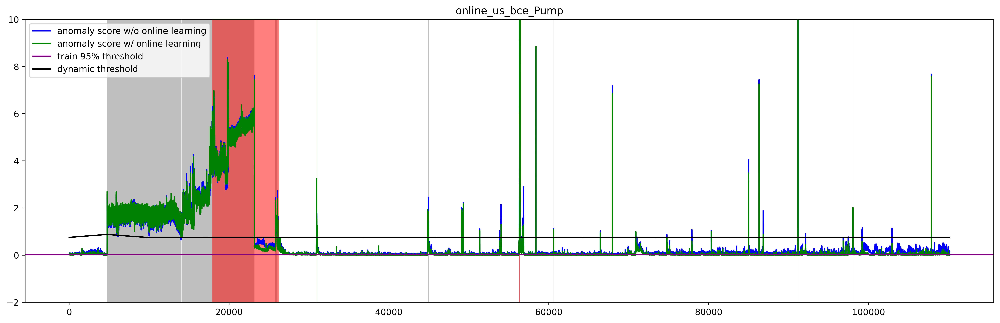

In [110]:
#s, e = 26751, 26851
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_{args.dataset}")
plt.ylim([-2, 10])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=.5)
plot_interval(plt, test_y[s:e])
plt.legend()
plt.show()

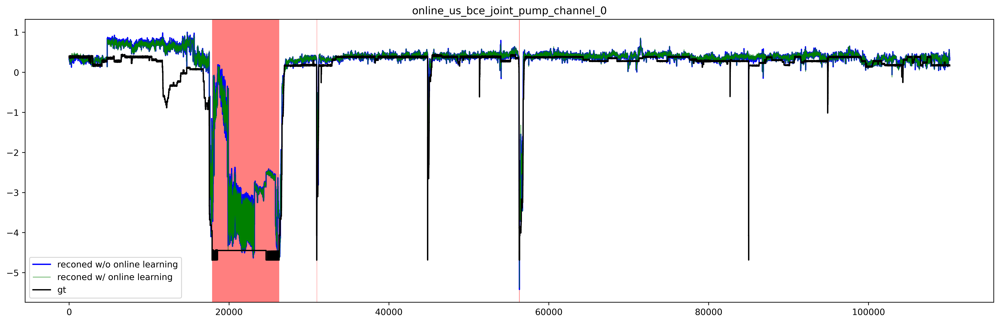

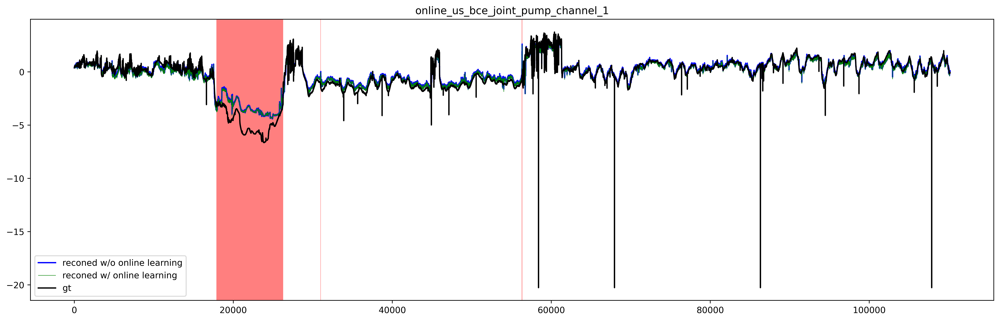

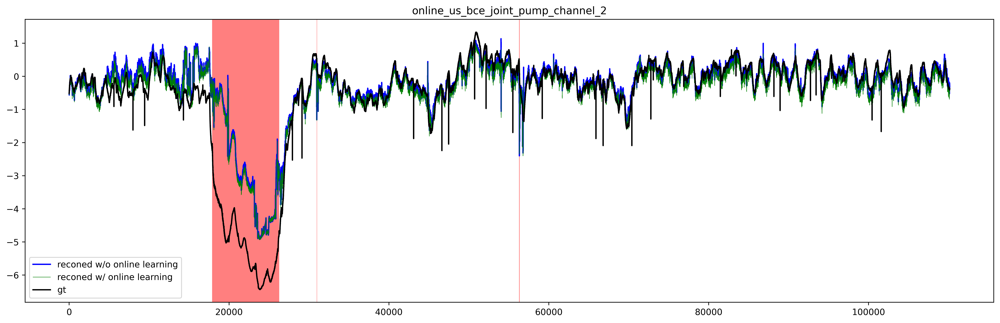

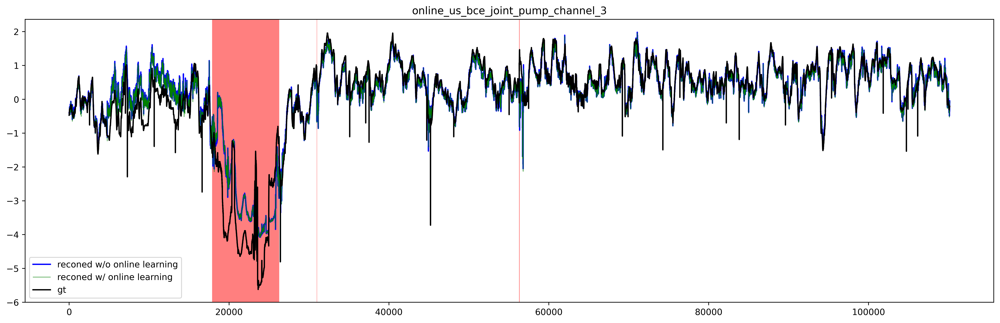

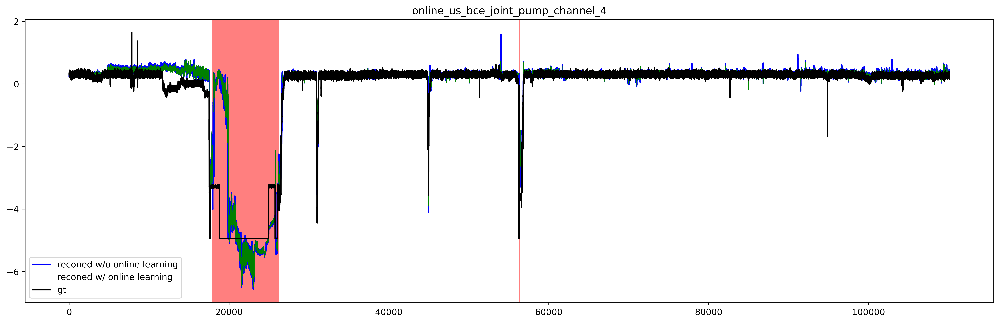

...

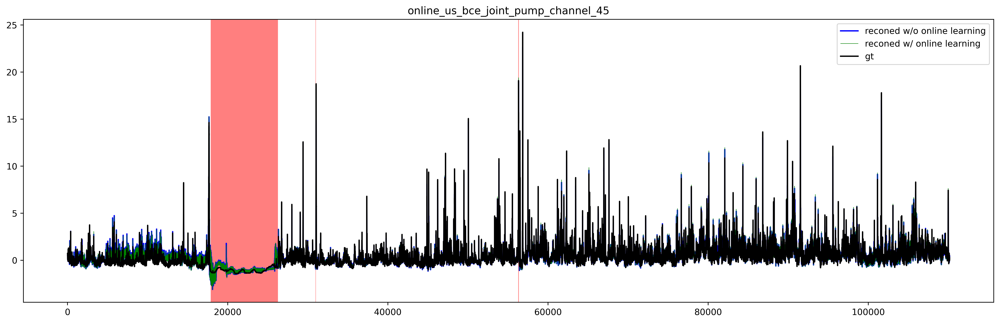

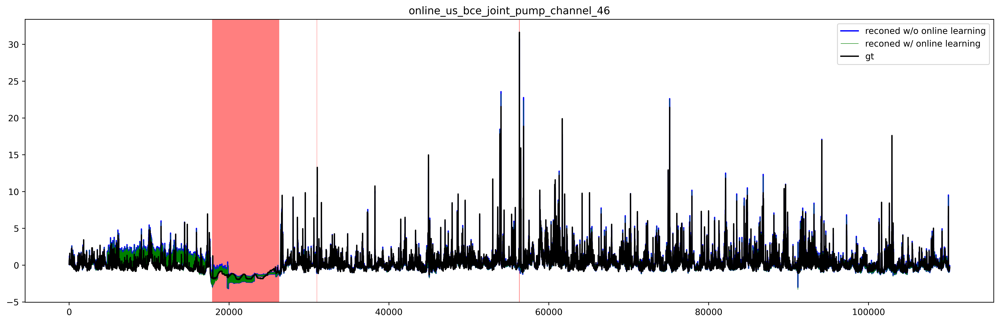

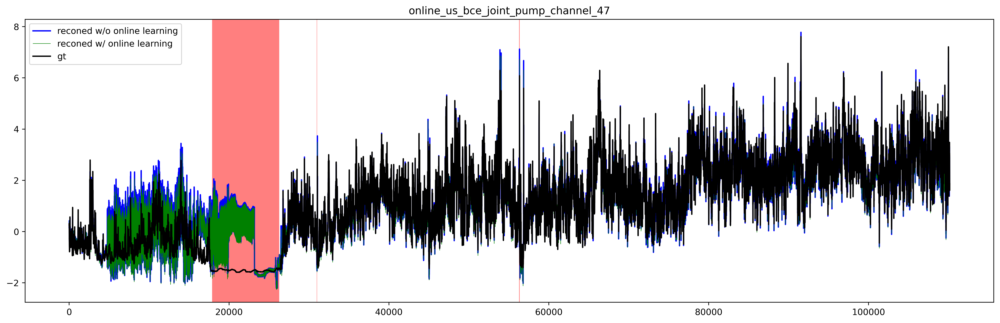

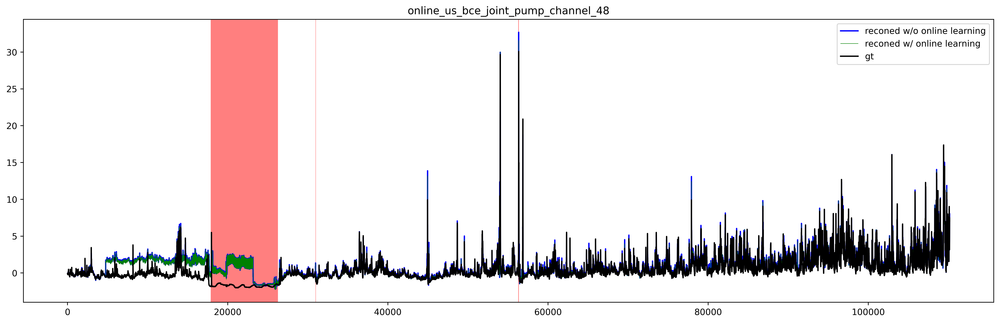

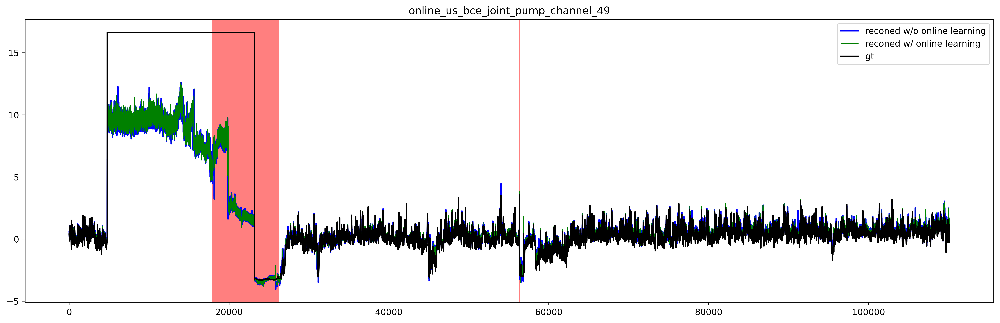

In [20]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.plot(test_X[:, c], color="black", label="gt")
    plt.legend()
    plot_interval(plt, test_y)

### Single + BCE + Joint

In [21]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

tensor(0.0284, requires_grad=True)

In [22]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_pump", f"best.pth"))

[2023-04-01 16:28:48,510] loading: ./checkpoints/MLP_pump/best.pth @Trainer - torch.load_state_dict
[2023-04-01 16:28:48,520] train_errors.pt file exists, loading...
[2023-04-01 16:28:48,528] torch.Size([110149, 12])
[2023-04-01 16:28:48,571] loading: ./checkpoints/MLP_PSM/best.pth @Trainer - torch.load_state_dict


RuntimeError: Error(s) in loading state_dict for MLP:
	size mismatch for encoder.linear1.weight: copying a param with shape torch.Size([150, 300]) from checkpoint, the shape in current model is torch.Size([300, 600]).
	size mismatch for encoder.linear1.bias: copying a param with shape torch.Size([150]) from checkpoint, the shape in current model is torch.Size([300]).
	size mismatch for encoder.linear2.weight: copying a param with shape torch.Size([75, 150]) from checkpoint, the shape in current model is torch.Size([150, 300]).
	size mismatch for encoder.linear2.bias: copying a param with shape torch.Size([75]) from checkpoint, the shape in current model is torch.Size([150]).
	size mismatch for encoder.linear3.weight: copying a param with shape torch.Size([128, 75]) from checkpoint, the shape in current model is torch.Size([128, 150]).
	size mismatch for decoder.linear1.weight: copying a param with shape torch.Size([75, 128]) from checkpoint, the shape in current model is torch.Size([150, 128]).
	size mismatch for decoder.linear1.bias: copying a param with shape torch.Size([75]) from checkpoint, the shape in current model is torch.Size([150]).
	size mismatch for decoder.linear2.weight: copying a param with shape torch.Size([150, 75]) from checkpoint, the shape in current model is torch.Size([300, 150]).
	size mismatch for decoder.linear2.bias: copying a param with shape torch.Size([150]) from checkpoint, the shape in current model is torch.Size([300]).
	size mismatch for decoder.linear3.weight: copying a param with shape torch.Size([300, 150]) from checkpoint, the shape in current model is torch.Size([600, 300]).
	size mismatch for decoder.linear3.bias: copying a param with shape torch.Size([300]) from checkpoint, the shape in current model is torch.Size([600]).

In [ ]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([thr]+[p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals and update threshold
    TT_optimizer.zero_grad()
    mask = (ytilde == 0)
    yhat = torch.sigmoid((A - thr))
    cls_loss = bce(yhat, ytilde.float())
    recon_loss = (A * mask).mean()
    loss = recon_loss + cls_loss
    loss.backward()
    TT_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

In [ ]:
# result summary
print(test_y.shape, preds.shape)
result = get_summary_stats(test_y, preds)
print(result)

In [ ]:
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_us_bce_joint_{args.dataset}")
plt.ylim([-1, 5])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plt.legend()
plt.show()

In [ ]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.plot(test_X[:, c], color="black", label="gt")
    plt.legend()
    plot_interval(plt, test_y)

### Single + BCE + Label

In [ ]:
thr = torch.quantile(train_error_dist, 0.95).detach().item()
thr = torch.tensor(thr, requires_grad=True)
thr

In [ ]:
tester = MLP_Tester(
    args=args,
    logger=logger,
    train_loader=train_loader,
    test_loader=test_loader,
)
tester.load(os.path.join("./checkpoints/MLP_pump", f"best.pth"))

In [ ]:
eval_iterator = tqdm(
    tester.test_loader,
    total=len(tester.test_loader),
    desc="calculating reconstruction errors",
    leave=True
)

lr = 1e-03
TT_optimizer = torch.optim.SGD([thr]+[p for p in tester.model.parameters()], lr=lr)
bce = torch.nn.BCELoss()

Xs, Xhats = [], []
yhats = []
preds = []
As, thrs =[], []

for i, batch_data in enumerate(eval_iterator):
    X, y = batch_data[0].to(tester.args.device), batch_data[1].to(tester.args.device)
    B, L, C = X.shape
    
    # inference
    Xhat = tester.model(X)
    E = F.mse_loss(Xhat, X, reduction='none')
    A = E.mean(dim=2)
    ytilde = (A > thr).float()
    pred = (A > thr)
    
    # log source model outputs
    Xs.append(X)
    Xhats.append(Xhat.clone().detach())
    As.append(A.clone().detach())
    preds.append(pred.clone().detach())
    thrs.append(thr.clone().detach().item())
    
    # learn new-normals and update threshold
    TT_optimizer.zero_grad()
    mask = (y == 0)
    yhat = torch.sigmoid((A - thr))
    cls_loss = bce(yhat, y.float())
    recon_loss = (A * mask).mean()
    loss = recon_loss + cls_loss
    loss.backward()
    TT_optimizer.step()
    
    
Xs = torch.cat(Xs, axis=0).detach().cpu().numpy()    
Xhats = torch.cat(Xhats, axis=0).detach().cpu().numpy()

anoscs = torch.cat(As, axis=0).reshape(-1).detach().cpu().numpy()
thrs = np.repeat(np.array(thrs), args.window_size*args.eval_batch_size)
preds = torch.cat(preds).reshape(-1).detach().cpu().numpy()

In [ ]:
# result summary
print(test_y.shape, preds.shape)
result = get_summary_stats(test_y, preds)
print(result)

In [ ]:
s, e = 0, -1
plt.figure(figsize=(20, 6), dpi=500)
plt.title(f"online_label_bce_joint_{args.dataset}")
plt.ylim([-1, 50])
plt.plot(anoscs_prev[s:e], color="blue", label="anomaly score w/o online learning")
plt.plot(anoscs[s:e], color="green", label="anomaly score w/ online learning")
plt.axhline(th_q95, color="purple", label="train 95% threshold")
plt.plot(thrs[s:e], color="black",label="dynamic threshold")

plot_interval(plt, test_y[s:e])
plot_interval(plt, preds.astype(int)[s:e], facecolor="gray", alpha=0.5)
plt.legend()
plt.show()

In [ ]:
# plot recon
c = 0
for c in range(args.num_channels):
    test_X, test_y = test_dataset.X, test_dataset.y

    B, L, C = Xhats.shape

    plt.figure(figsize=(20, 6), dpi=500)
    plt.title(f"online_us_bce_joint_{args.dataset}_channel_{c}")

    plt.plot(Xhats_prev[:,:,c].reshape(-1), color="blue", label="reconed w/o online learning")
    plt.plot(Xhats[:,:,c].reshape(-1), linewidth=0.5, color="green", label="reconed w/ online learning")
    plt.plot(test_X[:, c], color="black", label="gt")
    plt.legend()
    plot_interval(plt, test_y)